<a href="https://colab.research.google.com/github/annieptba/data2040_sp21_midterm_project/blob/main/RAD_Final_Blog_Post_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##**1. SETTING UP & KAGGLE API**

In [1]:
# set up libraries and environment
import math, re, os
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from tensorflow import keras
from functools import partial
from sklearn.model_selection import train_test_split
import numpy as np 
import pandas as pd
import gc
import random
from sklearn.model_selection import train_test_split
from keras.utils import to_categorical
from tqdm import tqdm
from keras.preprocessing import image
from keras.preprocessing.image import img_to_array, load_img, ImageDataGenerator
import cv2
from random import shuffle
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, Dropout, Flatten, Dense, Activation, BatchNormalization, ReLU
import keras
from keras.layers import Dense, Dropout, Input, MaxPooling2D, ZeroPadding2D, Conv2D, Flatten
from keras.models import Sequential, Model
from keras.losses import categorical_crossentropy
from keras.optimizers import Adam, SGD
from keras.preprocessing.image import img_to_array, load_img, ImageDataGenerator
from keras.utils import to_categorical
from tensorflow.keras import regularizers
import pandas as pd
import json
from keras.callbacks import EarlyStopping
from tensorflow.keras.layers import MaxPool2D, AveragePooling2D, GlobalAveragePooling2D
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from keras.callbacks import ReduceLROnPlateau
from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.regularizers import l2
from tensorflow.keras.layers.experimental import preprocessing
from tensorflow.keras.optimizers.schedules import ExponentialDecay
from keras.applications.vgg16 import VGG16
from keras.applications.mobilenet import MobileNet
from keras.applications.resnet50 import ResNet50
from keras.applications.densenet import DenseNet121
from keras.callbacks import ModelCheckpoint
from tensorflow.keras import layers

import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid

from zipfile import ZipFile
import time
from datetime import timedelta
from io import BytesIO

# image manipulation.
import PIL.Image
import seaborn as sns
import plotly.express as px

import pickle
import os

import random
print("Tensorflow version " + tf.__version__)

Tensorflow version 2.4.1


In [2]:
# uninstall and reinstall kaggle
!pip uninstall -y kaggle
!pip install -q kaggle

Uninstalling kaggle-1.5.10:
  Successfully uninstalled kaggle-1.5.10
     |████████████████████████████████| 61kB 3.0MB/s 


In [3]:
# set Kaggle username and API key
os.environ["KAGGLE_USERNAME"] = 'drewsolomon'
os.environ["KAGGLE_KEY"] = '394c2e9f24d40740b88dbd424a87235f'

# download the data from the kaggle competition
raw_data_dir = "input/raw"
!kaggle competitions download -c cassava-leaf-disease-classification -p {raw_data_dir}
'done'

100% 5.76G/5.76G [01:00<00:00, 63.3MB/s]
100% 5.76G/5.76G [01:00<00:00, 103MB/s] 


'done'

In [4]:
# check zip file download
!ls {raw_data_dir}

cassava-leaf-disease-classification.zip


In [5]:
# access zipped folders using Fuze zip #Nice, did not know of this :)
!apt-get install -y fuse-zip

# set input directory
input_dir = "/tmp/kaggle-data"
!mkdir {input_dir}
# fuze zip
!fuse-zip input/raw/cassava-leaf-disease-classification.zip {input_dir}
# check directory
!ls {input_dir}

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  libzip4
The following NEW packages will be installed:
  fuse-zip libzip4
0 upgraded, 2 newly installed, 0 to remove and 30 not upgraded.
Need to get 65.6 kB of archives.
After this operation, 178 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 libzip4 amd64 1.1.2-1.1 [37.8 kB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/universe amd64 fuse-zip amd64 0.4.4-1 [27.9 kB]
Fetched 65.6 kB in 0s (160 kB/s)
Selecting previously unselected package libzip4:amd64.
(Reading database ... 160980 files and directories currently installed.)
Preparing to unpack .../libzip4_1.1.2-1.1_amd64.deb ...
Unpacking libzip4:amd64 (1.1.2-1.1) ...
Selecting previously unselected package fuse-zip.
Preparing to unpack .../fuse-zip_0.4.4-1_amd64.deb ...
Unpacking fuse-zip (0.4.4-1) ...
Setting up libzip4:amd64 (1

In [6]:
# Use this path to access the downloaded folders
base_path = '/tmp/kaggle-data/'

os.listdir(base_path)

['label_num_to_disease_map.json',
 'sample_submission.csv',
 'test_images',
 'test_tfrecords',
 'train.csv',
 'train_images',
 'train_tfrecords']

In [7]:
# See the files inside train and test tfrecordds
print('files in train tfrecords:')
print(os.listdir(base_path + 'train_tfrecords'))
print('files in test tfrecords:')
print(os.listdir(base_path + 'test_tfrecords'))

files in train tfrecords:
['ld_train00-1338.tfrec', 'ld_train01-1338.tfrec', 'ld_train02-1338.tfrec', 'ld_train03-1338.tfrec', 'ld_train04-1338.tfrec', 'ld_train05-1338.tfrec', 'ld_train06-1338.tfrec', 'ld_train07-1338.tfrec', 'ld_train08-1338.tfrec', 'ld_train09-1338.tfrec', 'ld_train10-1338.tfrec', 'ld_train11-1338.tfrec', 'ld_train12-1338.tfrec', 'ld_train13-1338.tfrec', 'ld_train14-1338.tfrec', 'ld_train15-1327.tfrec']
files in test tfrecords:
['ld_test00-1.tfrec']


In [8]:
# See the lenght of train and test tfrecordds
print(len(os.listdir(base_path + 'train_tfrecords')))
print(len(os.listdir(base_path + 'test_tfrecords')))


16
1


##**2. LOADING AND PREPROCESSING TFRECORDS**

**Loading tfrecords**

In [9]:
AUTOTUNE = tf.data.experimental.AUTOTUNE
BATCH_SIZE = 64
IMAGE_SIZE = [224, 224]

In [10]:
FILENAMES = tf.io.gfile.glob(base_path + "train_tfrecords/ld_train*.tfrec")
TEST_FILENAMES = tf.io.gfile.glob(base_path + "test_tfrecords/ld_test*.tfrec")
split_ind = int(0.9 * len(FILENAMES))
TRAINING_FILENAMES, VALID_FILENAMES = FILENAMES[:split_ind], FILENAMES[split_ind:]

print("Train TFRecord Files:", len(TRAINING_FILENAMES))
print("Validation TFRecord Files:", len(VALID_FILENAMES))
print("Test TFRecord Files:", len(TEST_FILENAMES))

# source: https://keras.io/examples/keras_recipes/tfrecord/

Train TFRecord Files: 14
Validation TFRecord Files: 2
Test TFRecord Files: 1


In [11]:
# function to decode image
def decode_image(image):
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, size=IMAGE_SIZE) 
    image = tf.cast(image/255.0, tf.float32) 
    return image

# source: https://keras.io/examples/keras_recipes/tfrecord/

In [12]:
# function to read tf_records
def read_tfrecord(example, labeled):
    tfrecord_format = (
        {
            "image": tf.io.FixedLenFeature([], tf.string),
            "target": tf.io.FixedLenFeature([], tf.int64),
        }
        if labeled
        else {"image": tf.io.FixedLenFeature([], tf.string),}
    )
    example = tf.io.parse_single_example(example, tfrecord_format)
    image = decode_image(example["image"])
    if labeled:
        label = tf.cast(example["target"], tf.float32) 
        return image, label
    return image
    
# source: https://keras.io/examples/keras_recipes/tfrecord/

In [13]:
# function to load dataset
def load_dataset(filenames, labeled=True):
    ignore_order = tf.data.Options()
    ignore_order.experimental_deterministic = False  # disable order, increase speed
    dataset = tf.data.TFRecordDataset(
        filenames
    )  # automatically interleaves reads from multiple files
    dataset = dataset.with_options(
        ignore_order
    )  # uses data as soon as it streams in, rather than in its original order
    dataset = dataset.map(
        partial(read_tfrecord, labeled=labeled), num_parallel_calls=AUTOTUNE
    )
    # returns a dataset of (image, label) pairs if labeled=True or just images if labeled=False
    return dataset

# source: https://keras.io/examples/keras_recipes/tfrecord/

In [14]:
# function to load dataset, shuffle data, prefetch data, and set batch size
def get_dataset(filenames, labeled=True):
    dataset = load_dataset(filenames, labeled=labeled)
    # set shuffle buffer size to length of filenames, for full shuffle
    dataset = dataset.shuffle(384) 
    dataset = dataset.prefetch(buffer_size=AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE)
    return dataset

# source: https://keras.io/examples/keras_recipes/tfrecord/

In [15]:
train_dataset = get_dataset(TRAINING_FILENAMES)
valid_dataset = get_dataset(VALID_FILENAMES)
test_dataset = get_dataset(TEST_FILENAMES, labeled=False)

# source: https://keras.io/examples/keras_recipes/tfrecord/

**Displaying Images from tfrecords**

In [ ]:
image_batch, label_batch = next(iter(train_dataset))

In [ ]:
# load the labels map json file
with open(base_path + 'label_num_to_disease_map.json', 'rb') as f:
    jsonlabels = json.load(f)
    
# add labels from json file into dictionary
labels_dict = {}
labels_dict[0] = jsonlabels['0']
labels_dict[1] = jsonlabels['1']
labels_dict[2] = jsonlabels['2']
labels_dict[3] = jsonlabels['3']
labels_dict[4] = jsonlabels['4']

# print labels dictionary
labels_dict

{0: 'Cassava Bacterial Blight (CBB)',
 1: 'Cassava Brown Streak Disease (CBSD)',
 2: 'Cassava Green Mottle (CGM)',
 3: 'Cassava Mosaic Disease (CMD)',
 4: 'Healthy'}

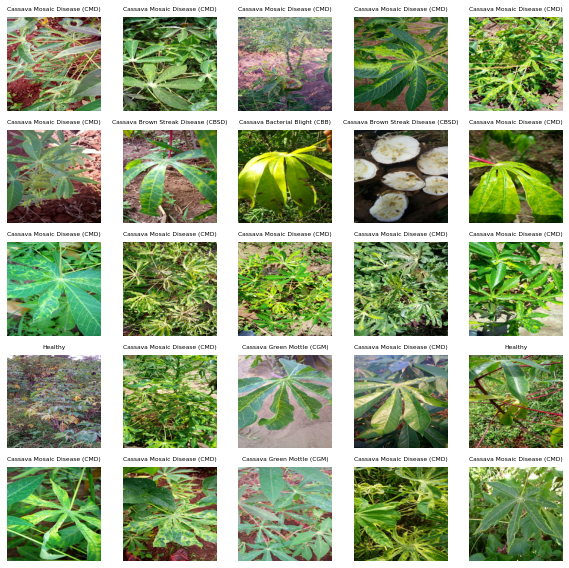

In [ ]:
def show_batch(image_batch, label_batch):
    plt.figure(figsize=(10, 10))
    for n in range(25):
        ax = plt.subplot(5, 5, n + 1)
        plt.imshow(image_batch[n])
        plt.title(labels_dict[label_batch[n]], size=6)           
        plt.axis("off")


# show batch with labels
show_batch(image_batch.numpy(), label_batch.numpy())

**Displaying Augmented Images from tfrecords**

In [16]:
# data augmentation: brighten
def brighten_img(x, max_delta=0.1):
    x = tf.image.random_brightness(x, max_delta)
    return x
def brighten(max_delta=0.1):
    return layers.Lambda(lambda x: brighten_img(x, max_delta))

In [17]:
# data augmentation: 
def saturate_img(x, lower=0.6, upper=1.3):
    x = tf.image.random_saturation(x, lower, upper)
    return x
def saturate(lower=0.6, upper=1.3):
    return layers.Lambda(lambda x: saturate_img(x, lower, upper))

In [18]:
# data augmentation
img_augmentation = Sequential(
    [
        #preprocessing.RandomCrop(height=224, width=224),
        preprocessing.RandomFlip("horizontal_and_vertical"),
        preprocessing.RandomRotation(0.25),
        preprocessing.RandomZoom((-0.7, -0.2)),
        preprocessing.RandomContrast(factor=0.1),
        #preprocessing.Normalization(),
        brighten(),
        saturate(),
    ],
    name="img_augmentation"
)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


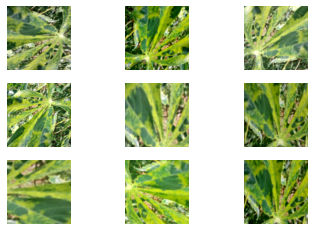

In [19]:
# show augmented image
for image,label in train_dataset.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        aug_img = img_augmentation(image)
        plt.imshow(aug_img[0])
        #plt.title("{}".format(format_label(label)))
        #plt.title(labels_dict[label_batch[n]], size=6)  
        plt.axis("off")


##**3.Exploratory Data Analysis**

In [ ]:
train_data = pd.read_csv(base_path + '/train.csv')

In [ ]:
# show head of training data
train_data.head()

,image_id,label
0,1000015157.jpg,0
1,1000201771.jpg,3
2,100042118.jpg,1
3,1000723321.jpg,1
4,1000812911.jpg,3


In [ ]:
# add class names to dataframe in new column
train_data["disease"] = train_data["label"].map(labels_dict)

In [ ]:
# print head
train_data.head()

,image_id,label,disease
0,1000015157.jpg,0,Cassava Bacterial Blight (CBB)
1,1000201771.jpg,3,Cassava Mosaic Disease (CMD)
2,100042118.jpg,1,Cassava Brown Streak Disease (CBSD)
3,1000723321.jpg,1,Cassava Brown Streak Disease (CBSD)
4,1000812911.jpg,3,Cassava Mosaic Disease (CMD)


In [ ]:
# get value counts by label
train_data['label'].value_counts()

3    13158
4     2577
2     2386
1     2189
0     1087
Name: label, dtype: int64

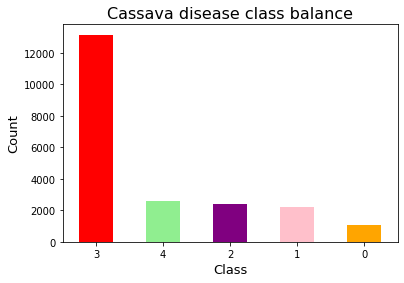

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# plot count by class
pd.value_counts(train_data['label']).plot.bar(color=['red', 'lightgreen', 'purple', 'pink', 'orange'])
plt.title('Cassava disease class balance', fontsize=16)
plt.xlabel('Class', fontsize=13)
plt.ylabel('Count', fontsize=13)
y_pos = np.arange(5)
plt.xticks(y_pos, rotation=0)
plt.savefig(base_path + 'cassava_disease_class_balance.jpg',bbox_inches='tight')
plt.show()

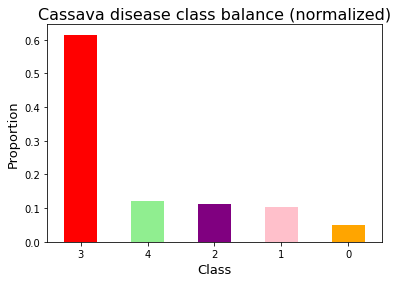

In [ ]:
# plot class balance
pd.value_counts(train_data['label'], normalize=True).plot.bar(color=['red', 'lightgreen', 'purple', 'pink', 'orange'])
plt.title('Cassava disease class balance (normalized)', fontsize=16)
plt.xlabel('Class', fontsize=13)
plt.ylabel('Proportion', fontsize=13)
y_pos = np.arange(5)
plt.xticks(y_pos, rotation=0)
plt.savefig(base_path + 'cassava_disease_class_balance(normalized).jpg',bbox_inches='tight')
plt.show()

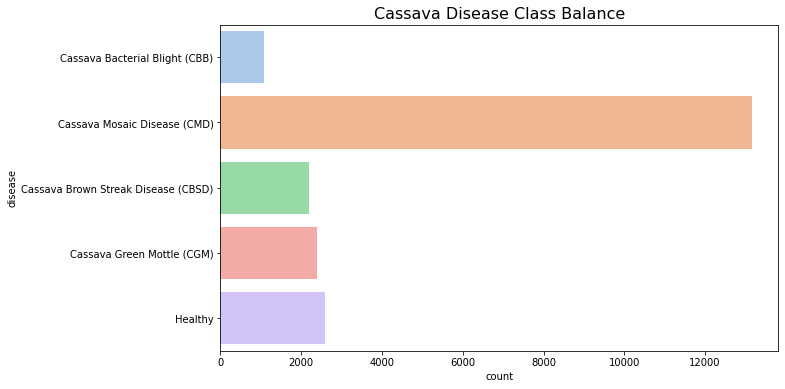

In [ ]:
#import seaborn as sns
plt.figure(figsize=(10, 6))
plt.title('Cassava Disease Class Balance', fontsize=16)
sns.countplot(y="disease", data=train_data, palette="pastel");
plt.savefig(base_path + 'cassava_disease_class_balance(horizontal).jpg',bbox_inches='tight')
plt.show()

In [ ]:
#import plotly.express as px
# Counting the Number of Training Samples for each Label
labelCounts = train_data['disease'].value_counts().reset_index()
labelCounts.columns = ['Label', 'Number of Observations']

# Plot Pie to show Proportions
fig = px.pie(labelCounts, 
             names = 'Label',values='Number of Observations', 
             labels = train_data['disease'], 
             title = 'Cassava Disease Class Balance (Normalized)')
plt.savefig(base_path + 'cassava_disease_class_balance(normalized)pie.jpg',bbox_inches='tight')
fig.show()

<Figure size 432x288 with 0 Axes>

In [ ]:
# print class balances
pd.value_counts(train_data['disease'], normalize=True)

Cassava Mosaic Disease (CMD)           0.614946
Healthy                                0.120437
Cassava Green Mottle (CGM)             0.111511
Cassava Brown Streak Disease (CBSD)    0.102304
Cassava Bacterial Blight (CBB)         0.050802
Name: disease, dtype: float64

In [ ]:
sample_submission = pd.read_csv(base_path + 'sample_submission.csv')

In [ ]:
sample_submission.head()

,image_id,label
0,2216849948.jpg,4


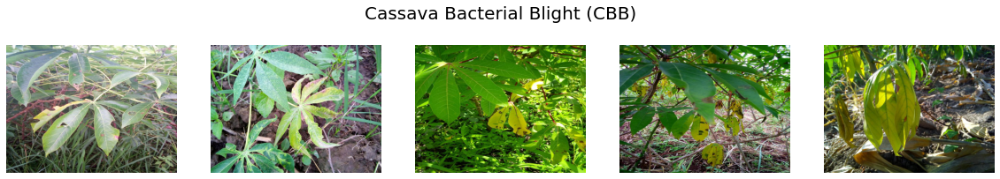

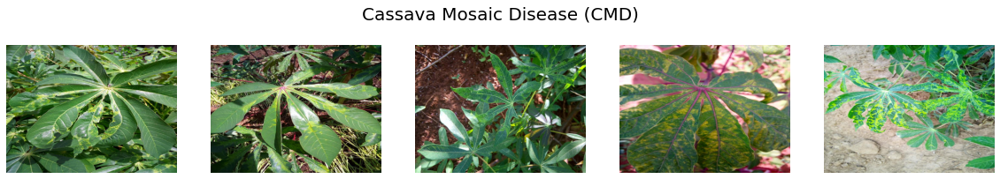

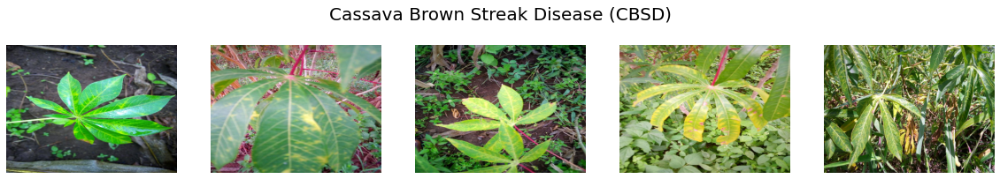

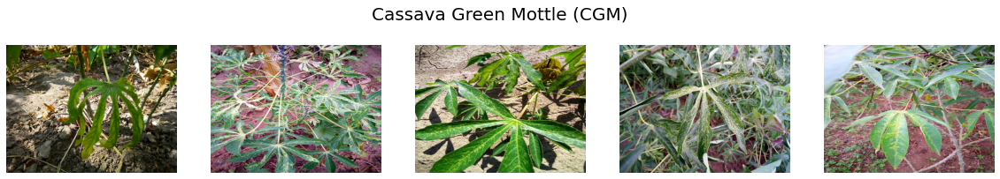

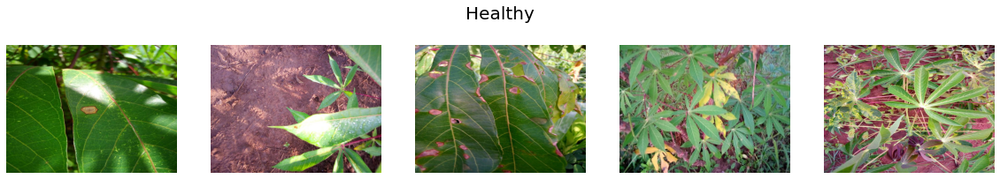

In [ ]:
# set random seed
np.random.seed(2020)
# plot 5 random samples for each class, by leaf disease
for class_name in train_data['disease'].unique():
    plt.figure(figsize=(20,50))
    for idx,img_name in enumerate(np.random.choice(train_data[train_data['disease'] == class_name]['image_id'].values,
                                                   size=5,replace=False)):
        plt.subplot(1,5,idx+1)
        #read the image and convert BGR color space to RGB
        img = cv2.cvtColor(cv2.imread(base_path+'train_images/'+img_name), cv2.COLOR_BGR2RGB)
        plt.imshow(img)
        plt.axis('off')
        # add title to center plot
        if idx ==2:
          plt.title(str(class_name), fontsize=20, pad=30)
          plt.subplots_adjust(hspace=1)
    # save figure
    plt.savefig(base_path + 'example_images_for_each_class.jpg',bbox_inches='tight')
    plt.show()

In [ ]:
for class_name in train_data['disease'].unique():
  print(class_name)

Cassava Bacterial Blight (CBB)
Cassava Mosaic Disease (CMD)
Cassava Brown Streak Disease (CBSD)
Cassava Green Mottle (CGM)
Healthy


In [ ]:
train_data.label

0        0
1        3
2        1
3        1
4        3
        ..
21392    3
21393    3
21394    1
21395    4
21396    4
Name: label, Length: 21397, dtype: int64

In [ ]:
# convert labels to strings for sparse class mode
train_data.label = train_data.label.astype('str')

# separate and augment training images
train_generator = ImageDataGenerator(validation_split = 0.2,
                                     rotation_range = 20,
                                     preprocessing_function = None,
                                     zoom_range = 0.2,
                                     cval = 0.2,
                                     horizontal_flip = True,
                                     vertical_flip = True,
                                     fill_mode = 'nearest',
                                     shear_range = 0.3,
                                     height_shift_range = 0.3,
                                     width_shift_range = 0.3) \
    .flow_from_dataframe(train_data,
                         directory = os.path.join(base_path, "train_images"),
                         subset = "training",
                         x_col = "image_id",
                         y_col = "label",
                         target_size = (IMAGE_SIZE),
                         batch_size = BATCH_SIZE,
                         class_mode = "sparse")

# separate and augment validation images
validation_generator = ImageDataGenerator(validation_split = 0.2) \
    .flow_from_dataframe(train_data,
                         directory = os.path.join(base_path, "train_images"),
                         subset = "validation",
                         x_col = "image_id",
                         y_col = "label",
                         target_size = (IMAGE_SIZE),
                         batch_size = BATCH_SIZE,
                         class_mode = "sparse")
'done'

Found 17118 validated image filenames belonging to 5 classes.
Found 4279 validated image filenames belonging to 5 classes.


'done'

In [ ]:
# print images in training set
print("images in training set: ", train_generator.n)

# printing images in validation set
print("images in validation set: ", validation_generator.n)

images in training set:  17118
images in validation set:  4279


In [ ]:
# training set balance
pd.value_counts(train_generator.classes, normalize=True)

3    0.614558
4    0.120750
2    0.110469
1    0.102407
0    0.051817
dtype: float64

In [ ]:
# validation set balance
pd.value_counts(validation_generator.classes, normalize=True)

3    0.616499
4    0.119187
2    0.115681
1    0.101893
0    0.046740
dtype: float64

##**4. TRANSFER LEARNING/ FINE TUNING CNN MODELS**

**Set up for CNN models**

In [19]:
# setup tensorboard, directories
!rm -rf ./logs
!mkdir ./logs/
!mkdir ./logs/midterm

log_dir="./logs/midterm/"
def tensorboard_callback(exp_name):
  return tf.keras.callbacks.TensorBoard(log_dir= log_dir + exp_name, profile_batch=0, histogram_freq=1)
# launch tensorboard with specific directory
%reload_ext tensorboard
%tensorboard --logdir logs/midterm

<IPython.core.display.Javascript object>

In [20]:
# set hyperparameters
BATCH = 128 # 64 
EPOCHS = 100 #300 #100 #20

In [21]:
# Early Stopping
early_stopping_callback = tf.keras.callbacks.EarlyStopping(
    monitor = 'val_loss',
    min_delta=0.001,
    patience=10,
    verbose=0,
    mode="auto",
    baseline=None,
    restore_best_weights=True,
)

In [22]:
# Model Checkpoint
checkpoint_filepath = '/tmp/kaggle-data/checkpoint'
model_checkpoint_callback = ModelCheckpoint(
    filepath=checkpoint_filepath,
    monitor='val_accuracy',
    verbose=1,
    save_best_only=True,
    save_weights_only=False,
    mode="max",
    save_freq="epoch")

In [23]:
# ReducedonPlateau
reduce_lr_callback = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=5, min_lr=0.000000001)

**Baseline Model**

In [ ]:
from keras.applications.vgg16 import VGG16
def create_base_model():
    vgg_model = VGG16(include_top = False, weights = 'imagenet', input_tensor = Input(shape=(224, 224, 3)))

    # freeze the model
    for layer in vgg_model.layers:
      layer.trainable = False
    # check frozen layers
    for i, layer in enumerate(vgg_model.layers):
      print(i, layer.name, layer.trainable)
    
    # define inputs
    inputs = tf.keras.layers.Input(shape=(224, 224, 3))
    # do data augmentation on inputs
    x = img_augmentation(inputs)
    # call the base model on inputs
    x = vgg_model(x)
    
    # Fine-tuning
    x = tf.keras.layers.GlobalAveragePooling2D()(x) # add global average pooling layer - color 

    # Output layer - output dimension=5 because we have 5 classes
    outputs = tf.keras.layers.Dense(5, activation = "softmax")(x)

    # putting the model together
    model = tf.keras.Model(inputs=inputs, outputs=outputs)

    # compile model with Adam, sparse_categorical_crossentropy loss, and accuracy metric
    model.compile(optimizer = Adam(lr = 0.001),
                  loss = "sparse_categorical_crossentropy",
                  metrics = ["acc"])
 
    return model

In [ ]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

# create baseline model
baseline_model = create_base_model()
baseline_model.summary()

58892288/58889256 [==============================] - 0s 0us/step
0 input_1 False
1 block1_conv1 False
2 block1_conv2 False
3 block1_pool False
4 block2_conv1 False
5 block2_conv2 False
6 block2_pool False
7 block3_conv1 False
8 block3_conv2 False
9 block3_conv3 False
10 block3_pool False
11 block4_conv1 False
12 block4_conv2 False
13 block4_conv3 False
14 block4_pool False
15 block5_conv1 False
16 block5_conv2 False
17 block5_conv3 False
18 block5_pool False
Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
img_augmentation (Sequential (None, 224, 224, 3)       0         
_________________________________________________________________
vgg16 (Functional)           (None, 7, 7, 512)         14714688  
____________________________________________________________

In [ ]:
history = baseline_model.fit(
    train_dataset, 
    epochs = EPOCHS,
    validation_data=valid_dataset,
    verbose=1, 
    batch_size=BATCH,
    callbacks = [early_stopping_callback, tensorboard_callback('vgg_baseline_history')] #, model_checkpoint_callback
)

Epoch 1/100
293/293 [==============================] - 61s 203ms/step - loss: 0.9346 - acc: 0.6653 - val_loss: 0.9925 - val_acc: 0.6672
Epoch 2/100
293/293 [==============================] - 57s 190ms/step - loss: 0.9100 - acc: 0.6715 - val_loss: 0.9993 - val_acc: 0.6567
Epoch 3/100
293/293 [==============================] - 56s 187ms/step - loss: 0.8940 - acc: 0.6769 - val_loss: 0.9785 - val_acc: 0.6537
Epoch 4/100
293/293 [==============================] - 57s 191ms/step - loss: 0.8840 - acc: 0.6804 - val_loss: 0.9797 - val_acc: 0.6645
Epoch 5/100
293/293 [==============================] - 56s 188ms/step - loss: 0.8759 - acc: 0.6797 - val_loss: 1.0146 - val_acc: 0.6465
Epoch 6/100
293/293 [==============================] - 57s 191ms/step - loss: 0.8685 - acc: 0.6850 - val_loss: 0.9593 - val_acc: 0.6717
Epoch 7/100
293/293 [==============================] - 56s 186ms/step - loss: 0.8600 - acc: 0.6907 - val_loss: 0.9906 - val_acc: 0.6593
Epoch 8/100
293/293 [===========================

In [ ]:
# function to save the model just trained
def save_model(model):
  import os
  model_name = 'vgg_baseline_model.h5'
  save_dir = os.path.join(base_path, 'saved_models')
  
  # Save model and weights
  if not os.path.isdir(save_dir):
      os.makedirs(save_dir)
  model_path = os.path.join(save_dir, model_name)
  model.save(model_path)
  print('Saved trained model at %s ' % model_path)

In [ ]:
# save the model
save_model(baseline_model)

Saved trained model at /tmp/kaggle-data/saved_models/vgg_baseline_model.h5 


In [ ]:
# load the model
from keras.models import load_model
baseline_model = load_model('/tmp/kaggle-data/saved_models/vgg_baseline_model.h5')
'done !'

'done !'

In [ ]:
# evaluate on the validation set
baseline_model.evaluate(valid_dataset, batch_size=BATCH, verbose=1, 
                               callbacks= [early_stopping_callback])

42/42 [==============================] - 8s 162ms/step - loss: 0.9029 - acc: 0.6859


[0.9028842449188232, 0.6859287023544312]

In [ ]:
# save tensorboard
!tensorboard dev upload \
--logdir logs \
--name "midterm_project_baseline" \
--description "Tensorboard of baseline model for Cassava Leaf Disease Classification"
--one_shot

**Link to TensorBoard for Baseline Model**
https://tensorboard.dev/experiment/blulePA9RimYESNxF346Sw/

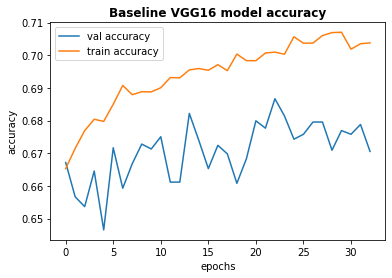

In [ ]:
# baseline model accuracy plot
plt.plot(history.history['val_acc'], label="val accuracy")
plt.plot(history.history['acc'],  label="train accuracy")
plt.title('Baseline VGG16 model accuracy', fontweight='bold')
plt.ylabel('accuracy')
plt.xlabel('epochs')
plt.legend()
plt.savefig(base_path + 'Baseline VGG16 model accuracy.jpg',bbox_inches='tight')
plt.show()

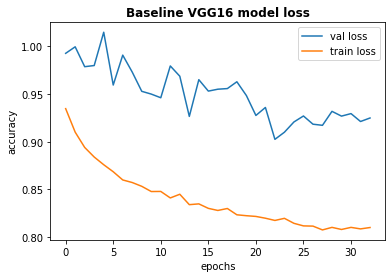

In [ ]:
# baseline model accuracy plot
plt.plot(history.history['val_loss'], label="val loss")
plt.plot(history.history['loss'],  label="train loss")
plt.title('Baseline VGG16 model loss', fontweight='bold')
plt.ylabel('accuracy')
plt.xlabel('epochs')
plt.legend()
plt.savefig(base_path + 'Baseline VGG16 model loss.jpg',bbox_inches='tight')
plt.show()

In [ ]:
# save history as dataframe
baseline_history_df = pd.DataFrame(history.history)

# save training history
pickle.dump(history.history, open( 'vgg_baseline_history' + '.pickle', "wb"))

In [ ]:
# load baseline training data
baseline_history = open('vgg_baseline_history' + '.pickle', "rb")

In [ ]:
# show baseline training history
baseline_history_df

,loss,acc,val_loss,val_acc
0,0.934582,0.665279,0.992487,0.667167
1,0.909992,0.671471,0.999311,0.656660
2,0.893986,0.676916,0.978498,0.653659
3,0.883958,0.680386,0.979712,0.664540
4,0.875906,0.679746,1.014555,0.646529
5,0.868548,0.684978,0.959313,0.671670
6,0.859963,0.690743,0.990603,0.659287
7,0.857264,0.687914,0.972828,0.666792
8,0.853293,0.688821,0.952725,0.672795
9,0.847837,0.688768,0.949821,0.671295


**Model 1: Fine-tuned MobileNet**

**MobileNet with Learning Rate Schedule**

In [24]:
# Fine Tuning MobileNet
def create_frozen_mobilenet_model_lite():

    # import MobileNet model
    mobilenet_model = MobileNet(include_top = False, weights = 'imagenet', input_tensor = Input(shape=(224, 224, 3)))
    # freeze four convolution blocks
    for layer in mobilenet_model.layers[:-6]: #[:-6]
      layer.trainable = False
    # check frozen layers
    for i, layer in enumerate(mobilenet_model.layers):
      print(i, layer.name, layer.trainable)
    
    # define inputs
    inputs = tf.keras.layers.Input(shape=(224, 224, 3))
    # do data augmentation on inputs
    x = img_augmentation(inputs)
    # call the base model on x
    x = mobilenet_model(x)


    # Fine-tuning
      # Combos
    x = tf.keras.layers.GlobalAveragePooling2D()(x) #add global average pooling layer - color 
    x = Dense(64, kernel_initializer = 'he_normal', kernel_regularizer='l2')(x) #l2(1e-3) #activation = "relu",
    x = BatchNormalization()(x)
    x = Dropout(rate = 0.5)(x)
    x = ReLU()(x)
      # Combos
    #x = Dense(64, activation = "relu", kernel_initializer = 'he_normal', kernel_regularizer='l2')(x) #activation = "relu",
    #x = BatchNormalization()(x)
    #x = Dropout(rate = 0.5)(x)
    #x = ReLU()(x)
   
    # Output layer - output dimension=5 because we have 5 classes
    outputs = tf.keras.layers.Dense(5, activation = "softmax")(x)

    # Put the model together
    model = tf.keras.Model(inputs=inputs, outputs=outputs)
    
    # compile model with Adam, sparse_categorical_crossentropy loss, and accuracy metric
    model.compile(optimizer = Adam(learning_rate=0.005), #0.001 #learning_rate=expo_decay_lr_schedule
                  loss = "sparse_categorical_crossentropy",
                  metrics = ["acc"])
 
    return model

In [25]:
frozen_mobilenet_lite = create_frozen_mobilenet_model_lite() 
frozen_mobilenet_lite.summary() 

17227776/17225924 [==============================] - 0s 0us/step
0 input_1 False
1 conv1 False
2 conv1_bn False
3 conv1_relu False
4 conv_dw_1 False
5 conv_dw_1_bn False
6 conv_dw_1_relu False
7 conv_pw_1 False
8 conv_pw_1_bn False
9 conv_pw_1_relu False
10 conv_pad_2 False
11 conv_dw_2 False
12 conv_dw_2_bn False
13 conv_dw_2_relu False
14 conv_pw_2 False
15 conv_pw_2_bn False
16 conv_pw_2_relu False
17 conv_dw_3 False
18 conv_dw_3_bn False
19 conv_dw_3_relu False
20 conv_pw_3 False
21 conv_pw_3_bn False
22 conv_pw_3_relu False
23 conv_pad_4 False
24 conv_dw_4 False
25 conv_dw_4_bn False
26 conv_dw_4_relu False
27 conv_pw_4 False
28 conv_pw_4_bn False
29 conv_pw_4_relu False
30 conv_dw_5 False
31 conv_dw_5_bn False
32 conv_dw_5_relu False
33 conv_pw_5 False
34 conv_pw_5_bn False
35 conv_pw_5_relu False
36 conv_pad_6 False
37 conv_dw_6 False
38 conv_dw_6_bn False
39 conv_dw_6_relu False
40 conv_pw_6 False
41 conv_pw_6_bn False
42 conv_pw_6_relu False
43 conv_dw_7 False
44 conv_dw_7_bn 

In [26]:
# fit mobilenet model and track history - base: unfreeze 1 block, fine-tune: GAP, dropout,  reduce 1 factor = 0.1, start 0.01 lr, img_augmentation:new
mobilenet_history_lite = frozen_mobilenet_lite.fit(
    train_dataset,
    epochs = EPOCHS,
    validation_data = valid_dataset,
    verbose = 1, 
    batch_size=BATCH,
    callbacks=[early_stopping_callback, reduce_lr_callback, tensorboard_callback('mobilenet_lite_finetuned_history'), model_checkpoint_callback] # reduce_lr_callback, 
)

Epoch 1/100
293/293 [==============================] - 67s 168ms/step - loss: 1.5166 - acc: 0.6418 - val_loss: 1.4848 - val_acc: 0.4270
Epoch 2/100
293/293 [==============================] - 60s 203ms/step - loss: 0.9522 - acc: 0.7085 - val_loss: 1.0150 - val_acc: 0.6750
Epoch 3/100
293/293 [==============================] - 58s 194ms/step - loss: 0.9032 - acc: 0.7237 - val_loss: 0.9320 - val_acc: 0.7096
Epoch 4/100
293/293 [==============================] - 56s 188ms/step - loss: 0.8927 - acc: 0.7244 - val_loss: 1.0114 - val_acc: 0.6698
Epoch 5/100
293/293 [==============================] - 56s 187ms/step - loss: 0.8906 - acc: 0.7276 - val_loss: 0.9483 - val_acc: 0.6859
Epoch 6/100
293/293 [==============================] - 56s 187ms/step - loss: 0.8822 - acc: 0.7290 - val_loss: 1.0146 - val_acc: 0.6841
Epoch 7/100
293/293 [==============================] - 56s 186ms/step - loss: 0.8775 - acc: 0.7288 - val_loss: 0.9032 - val_acc: 0.7268
Epoch 8/100
293/293 [===========================

In [27]:
# function to save the model just trained
def save_model(model):
  import os
  model_name = 'mobilenet_lite_finetuned_model.h5'
  save_dir = os.path.join(base_path, 'saved_models')
  
  # Save model and weights
  if not os.path.isdir(save_dir):
      os.makedirs(save_dir)
  model_path = os.path.join(save_dir, model_name)
  model.save(model_path)
  print('Saved trained model at %s ' % model_path)

In [28]:
# save the model
save_model(frozen_mobilenet_lite)

Saved trained model at /tmp/kaggle-data/saved_models/mobilenet_lite_finetuned_model.h5 


In [29]:
# load the model
from keras.models import load_model
frozen_mobilenet_lite = load_model('/tmp/kaggle-data/saved_models/mobilenet_lite_finetuned_model.h5')
'done !'

'done !'

In [30]:
# evaluate on validation set
frozen_mobilenet_lite.evaluate(valid_dataset, batch_size=BATCH, verbose=1, 
                               callbacks= [early_stopping_callback, reduce_lr_callback])

42/42 [==============================] - 7s 131ms/step - loss: 0.6693 - acc: 0.7644


[0.6692890524864197, 0.7643527388572693]

In [ ]:
# save tensorboard
!tensorboard dev upload \
--logdir logs \
--name "midterm_project_mobilenet_lite_finetuned" \
--description "Tensorboard of MobileNet with Learning Rate Schedule model for Cassava Leaf Disease Classification"
--one_shot

**Link to Tensorboard for Fine-tuned with Learning Rate Schedule  MobileNet Model**
https://tensorboard.dev/experiment/Nn5rOeNrSxG9UmqapO1rkw/

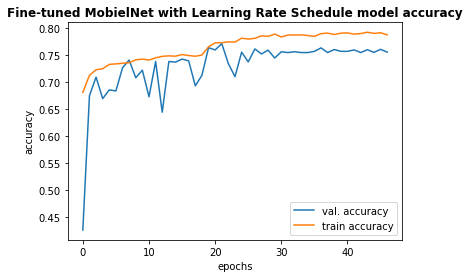

In [32]:
# mobielnet model accuracy plot
plt.plot(mobilenet_history_lite.history['val_acc'], label="val. accuracy")
plt.plot(mobilenet_history_lite.history['acc'],  label="train accuracy")
plt.title('Fine-tuned MobielNet with Learning Rate Schedule model accuracy', fontweight='bold')
plt.ylabel('accuracy')
plt.xlabel('epochs')
plt.legend()
plt.savefig(base_path + 'Fine-tuned MobileNet with Learning Rate Schedule  model accuracy.jpg',bbox_inches='tight')
plt.show()

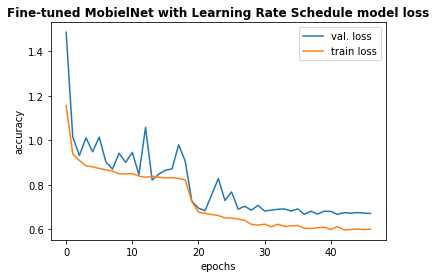

In [33]:
# mobielnet model loss plot
plt.plot(mobilenet_history_lite.history['val_loss'], label="val. loss")
plt.plot(mobilenet_history_lite.history['loss'],  label="train loss")
plt.title('Fine-tuned MobielNet with Learning Rate Schedule model loss', fontweight='bold')
plt.ylabel('accuracy')
plt.xlabel('epochs')
plt.legend()
plt.savefig(base_path + 'Fine-tuned MobileNet with Learning Rate Schedule model loss.jpg',bbox_inches='tight')
plt.show()

In [34]:
# save history as dataframe
mobilenet_lite_finetuned_history_df= pd.DataFrame(mobilenet_history_lite.history)

# save training history
pickle.dump(mobilenet_history_lite.history, open( 'mobilenet_lite_finetuned_history' + '.pickle', "wb"))

In [35]:
# load mobilenet training data
mobilenet_finetuned_history_lite = open('mobilenet_lite_finetuned_history' + '.pickle', "rb")

In [36]:
# show mobilenet training history
mobilenet_lite_finetuned_history_df

,loss,acc,val_loss,val_acc,lr
0,1.156078,0.681294,1.484752,0.427017,0.005000
1,0.939120,0.712951,1.014955,0.675047,0.005000
2,0.909683,0.723148,0.931961,0.709569,0.005000
3,0.884869,0.725123,1.011400,0.669794,0.005000
4,0.881243,0.733130,0.948308,0.685929,0.005000
5,0.873403,0.734038,1.014598,0.684053,0.005000
6,0.867616,0.735159,0.903225,0.726829,0.005000
7,0.861957,0.736227,0.871090,0.741088,0.005000
8,0.849163,0.741565,0.942248,0.708443,0.005000
9,0.849244,0.742846,0.900962,0.722326,0.005000


**Model 2: Fine-tuned ResNet**

**ResNet With Learning Rate Schedule**

In [38]:
# Fine Tuning Model ResNet
from keras.applications import ResNet101V2
def create_frozen_resnet_model_lite():
  
    # import resnet model
    resnet_model = ResNet101V2(include_top = False, weights = 'imagenet', input_tensor = Input(shape=(224, 224, 3)))    
    # freeze the model
    for layer in resnet_model.layers[:-13]: 
      layer.trainable = False
    # check frozen layers
    for i, layer in enumerate(resnet_model.layers):
      print(i, layer.name, layer.trainable)
 
    # define inputs
    inputs = tf.keras.layers.Input(shape=(224, 224, 3))
    # do data augmentation on inputs
    x = img_augmentation(inputs)
    # call the base model on x
    x = resnet_model(x)

    # Fine-tuning
      # Combos
    x = tf.keras.layers.GlobalAveragePooling2D()(x) #add global average pooling layer - color 
    x = Dense(64, kernel_initializer = 'he_normal', kernel_regularizer='l2')(x) #l2(1e-3) #activation = "relu",
    x = BatchNormalization()(x)
    x = Dropout(rate = 0.5)(x)
    x = ReLU()(x)
      # Combos
    #x = Dense(64, activation = "relu", kernel_initializer = 'he_normal', kernel_regularizer='l2')(x) #activation = "relu",
    #x = BatchNormalization()(x)
    #x = Dropout(rate = 0.5)(x)
    #x = ReLU()(x)

    # Output layer - output dimension=5 because we have 5 classes
    outputs = tf.keras.layers.Dense(5, activation = "softmax")(x)

    # Putting the model together
    model = tf.keras.Model(inputs=inputs, outputs=outputs)

    # compile model with Adam, sparse_categorical_crossentropy loss, and accuracy metric
    model.compile(optimizer = Adam(lr=0.005), #learning_rate=expo_decay_lr_schedule
                  loss = "sparse_categorical_crossentropy",
                  metrics = ["acc"])
  
    return model

In [39]:
frozen_resnet_lite = create_frozen_resnet_model_lite() 
frozen_resnet_lite.summary() 

171319296/171317808 [==============================] - 4s 0us/step
0 input_3 False
1 conv1_pad False
2 conv1_conv False
3 pool1_pad False
4 pool1_pool False
5 conv2_block1_preact_bn False
6 conv2_block1_preact_relu False
7 conv2_block1_1_conv False
8 conv2_block1_1_bn False
9 conv2_block1_1_relu False
10 conv2_block1_2_pad False
11 conv2_block1_2_conv False
12 conv2_block1_2_bn False
13 conv2_block1_2_relu False
14 conv2_block1_0_conv False
15 conv2_block1_3_conv False
16 conv2_block1_out False
17 conv2_block2_preact_bn False
18 conv2_block2_preact_relu False
19 conv2_block2_1_conv False
20 conv2_block2_1_bn False
21 conv2_block2_1_relu False
22 conv2_block2_2_pad False
23 conv2_block2_2_conv False
24 conv2_block2_2_bn False
25 conv2_block2_2_relu False
26 conv2_block2_3_conv False
27 conv2_block2_out False
28 conv2_block3_preact_bn False
29 conv2_block3_preact_relu False
30 conv2_block3_1_conv False
31 conv2_block3_1_bn False
32 conv2_block3_1_relu False
33 conv2_block3_2_pad False
34

In [41]:
# fit mobilenet model and track history - base: unfreeze 1 block, fine-tune: GAP, dropout, lr: reduce_lr factor = 0.1, start 0.01 , img_augmentation:new
resnet_history_lite = frozen_resnet_lite.fit(
    train_dataset,
    epochs = EPOCHS,
    validation_data = valid_dataset,
    verbose = 1, 
    batch_size=BATCH,
    callbacks=[early_stopping_callback, reduce_lr_callback, tensorboard_callback('resnet_lite_finetuned_history')] # reduce_lr_callback, #, model_checkpoint_callback
)

Epoch 1/100
293/293 [==============================] - 61s 205ms/step - loss: 0.8004 - acc: 0.7355 - val_loss: 0.8036 - val_acc: 0.7328
Epoch 2/100
293/293 [==============================] - 60s 201ms/step - loss: 0.7654 - acc: 0.7481 - val_loss: 0.7244 - val_acc: 0.7415
Epoch 3/100
293/293 [==============================] - 58s 195ms/step - loss: 0.7383 - acc: 0.7515 - val_loss: 0.7093 - val_acc: 0.7512
Epoch 4/100
293/293 [==============================] - 57s 191ms/step - loss: 0.7151 - acc: 0.7541 - val_loss: 0.7992 - val_acc: 0.7362
Epoch 5/100
293/293 [==============================] - 56s 189ms/step - loss: 0.7032 - acc: 0.7630 - val_loss: 0.7567 - val_acc: 0.7452
Epoch 6/100
293/293 [==============================] - 56s 187ms/step - loss: 0.6892 - acc: 0.7661 - val_loss: 0.7009 - val_acc: 0.7614
Epoch 7/100
293/293 [==============================] - 56s 186ms/step - loss: 0.6789 - acc: 0.7726 - val_loss: 0.8222 - val_acc: 0.7328
Epoch 8/100
293/293 [===========================

In [42]:
# function to save the model just trained
def save_model(model):
  import os
  model_name = 'resnet_lite_finetuned_model.h5'
  save_dir = os.path.join(base_path, 'saved_models')
  
  # Save model and weights
  if not os.path.isdir(save_dir):
      os.makedirs(save_dir)
  model_path = os.path.join(save_dir, model_name)
  model.save(model_path)
  print('Saved trained model at %s ' % model_path)

In [43]:
# save the model
save_model(frozen_resnet_lite)

Saved trained model at /tmp/kaggle-data/saved_models/resnet_lite_finetuned_model.h5 


In [44]:
# load the model
from keras.models import load_model
frozen_resnet_lite = load_model('/tmp/kaggle-data/saved_models/resnet_lite_finetuned_model.h5')
'done !'

'done !'

In [45]:
frozen_resnet_lite.evaluate(valid_dataset, batch_size=BATCH, verbose=1, 
                               callbacks= [early_stopping_callback, reduce_lr_callback])

42/42 [==============================] - 9s 157ms/step - loss: 0.6114 - acc: 0.7951


[0.6114120483398438, 0.795121967792511]

In [ ]:
# save tensorboard
!tensorboard dev upload \
--logdir logs \
--name "midterm_project_resnet_lite _finetuned" \
--description "Tensorboard of ResNet with Learning Rate Schedule model for Cassava Leaf Disease Classification"
--one_shot

**Link to TensoBoard for ResNet with Learning Rate Schedule**
https://tensorboard.dev/experiment/WNVvyxFrQ6GgMVUxn6kPuA/

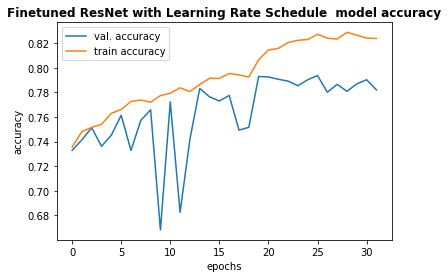

In [48]:
# resnet model accuracy plot
plt.plot(resnet_history_lite.history['val_acc'], label="val. accuracy")
plt.plot(resnet_history_lite.history['acc'],  label="train accuracy")
plt.title('Finetuned ResNet with Learning Rate Schedule  model accuracy', fontweight='bold')
plt.ylabel('accuracy')
plt.xlabel('epochs')
plt.legend()
plt.savefig(base_path + 'Finetuned ResNet with Learning Rate Schedule model accuracy.jpg',bbox_inches='tight')
plt.show()

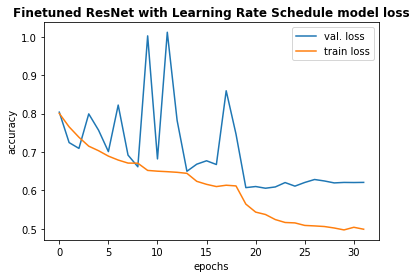

In [49]:
# resnet model loss plot
plt.plot(resnet_history_lite.history['val_loss'], label="val. loss")
plt.plot(resnet_history_lite.history['loss'],  label="train loss")
plt.title('Finetuned ResNet with Learning Rate Schedule model loss', fontweight='bold')
plt.ylabel('accuracy')
plt.xlabel('epochs')
plt.legend()
plt.savefig(base_path + 'Finetuned ResNet with Learning Rate Schedule model loss.jpg',bbox_inches='tight')
plt.show()

In [53]:
# save history as dataframe
ResNet_lite_finetuned_history_df = pd.DataFrame(resnet_history_lite .history)

# save training history
pickle.dump(resnet_history_lite.history, open('resnet_lite_finetuned_history' + '.pickle', "wb"))

In [54]:
# load baseline training data
ResNet_lite_finetuned_history = open('resnet_lite_finetuned_history' + '.pickle', "rb")

In [55]:
# show baseline training history
ResNet_lite_finetuned_history_df

,loss,acc,val_loss,val_acc,lr
0,0.800405,0.735533,0.803638,0.732833,0.00500
1,0.765422,0.748078,0.724444,0.741463,0.00500
2,0.738347,0.751548,0.709269,0.751220,0.00500
3,0.715061,0.754057,0.799191,0.736210,0.00500
4,0.703234,0.762972,0.756660,0.745216,0.00500
5,0.689170,0.766069,0.700911,0.761351,0.00500
6,0.678935,0.772582,0.822171,0.732833,0.00500
7,0.671028,0.773756,0.691832,0.757223,0.00500
8,0.670708,0.771994,0.661347,0.765854,0.00500
9,0.651915,0.777386,1.002484,0.668293,0.00500


**Model 3: Fine-tuned DenseNet**

**DenseNet With Learning Rate Schedule**

In [25]:
# Fine Tuning Model DenseNet
from keras.applications.densenet import DenseNet201 
def create_frozen_densenet_model_lite():

    # import densenet model
    densenet_model = DenseNet201(include_top = False, weights = 'imagenet', input_tensor = Input(shape=(224, 224, 3)))
    # unfreeze some layers and freeze the rest
    for layer in densenet_model.layers[:-9]: 
      layer.trainable = False
    # check frozen layers
    for i, layer in enumerate(densenet_model.layers):
      print(i, layer.name, layer.trainable)
    
    # define inputs
    inputs = tf.keras.layers.Input(shape=(224, 224, 3))
    # do data augmentation on inputs
    x = img_augmentation(inputs)
    # call the base model on x
    x =  densenet_model(x)

    # Fine-tuning
    x = tf.keras.layers.GlobalAveragePooling2D()(x) #add global average pooling layer - color 
    x = Dense(64, kernel_initializer = 'he_normal', kernel_regularizer='l2')(x) #l2(1e-3) #activation = "relu",
    x = BatchNormalization()(x)
    x = Dropout(rate = 0.5)(x)
    x = ReLU()(x)

    # Output layer - output dimension=5 because we have 5 classes
    outputs = tf.keras.layers.Dense(5, activation = "softmax")(x)

    # Put the model together
    model = tf.keras.Model(inputs=inputs, outputs=outputs)

    # compile model with Adam, sparse_categorical_crossentropy loss, and accuracy metric
    model.compile(optimizer = Adam(lr=0.005), #learning_rate=expo_decay_lr_schedule
                  loss = "sparse_categorical_crossentropy",
                  metrics = ["acc"])

    return model

In [26]:
frozen_densenet_lite = create_frozen_densenet_model_lite() 
frozen_densenet_lite.summary() 

74842112/74836368 [==============================] - 3s 0us/step
0 input_1 False
1 zero_padding2d False
2 conv1/conv False
3 conv1/bn False
4 conv1/relu False
5 zero_padding2d_1 False
6 pool1 False
7 conv2_block1_0_bn False
8 conv2_block1_0_relu False
9 conv2_block1_1_conv False
10 conv2_block1_1_bn False
11 conv2_block1_1_relu False
12 conv2_block1_2_conv False
13 conv2_block1_concat False
14 conv2_block2_0_bn False
15 conv2_block2_0_relu False
16 conv2_block2_1_conv False
17 conv2_block2_1_bn False
18 conv2_block2_1_relu False
19 conv2_block2_2_conv False
20 conv2_block2_concat False
21 conv2_block3_0_bn False
22 conv2_block3_0_relu False
23 conv2_block3_1_conv False
24 conv2_block3_1_bn False
25 conv2_block3_1_relu False
26 conv2_block3_2_conv False
27 conv2_block3_concat False
28 conv2_block4_0_bn False
29 conv2_block4_0_relu False
30 conv2_block4_1_conv False
31 conv2_block4_1_bn False
32 conv2_block4_1_relu False
33 conv2_block4_2_conv False
34 conv2_block4_concat False
35 conv2_

In [27]:
# fit mobilenet model and track history - base: unfreeze -6, fine-tune: GAP + drop_out 0.4, lr: reduce_lr factor = 0.1, start 0.01 , img_augmentation:3
densenet_history_lite = frozen_densenet_lite.fit(
    train_dataset,
    epochs = EPOCHS,
    validation_data = valid_dataset,
    verbose = 1, 
    batch_size=BATCH,
    callbacks=[early_stopping_callback, reduce_lr_callback, tensorboard_callback('densenet_lite_finetuned_history')] # reduce_lr_callback, , model_checkpoint_callback
)

Epoch 1/100
293/293 [==============================] - 81s 183ms/step - loss: 1.4396 - acc: 0.6513 - val_loss: 1.2315 - val_acc: 0.6765
Epoch 2/100
293/293 [==============================] - 56s 188ms/step - loss: 0.9307 - acc: 0.7289 - val_loss: 1.0013 - val_acc: 0.6784
Epoch 3/100
293/293 [==============================] - 55s 184ms/step - loss: 0.8557 - acc: 0.7529 - val_loss: 0.9006 - val_acc: 0.7261
Epoch 4/100
293/293 [==============================] - 54s 182ms/step - loss: 0.8169 - acc: 0.7592 - val_loss: 0.8289 - val_acc: 0.7546
Epoch 5/100
293/293 [==============================] - 54s 182ms/step - loss: 0.7703 - acc: 0.7690 - val_loss: 0.7861 - val_acc: 0.7542
Epoch 6/100
293/293 [==============================] - 56s 187ms/step - loss: 0.7387 - acc: 0.7771 - val_loss: 0.7368 - val_acc: 0.7681
Epoch 7/100
293/293 [==============================] - 54s 183ms/step - loss: 0.7134 - acc: 0.7842 - val_loss: 0.7741 - val_acc: 0.7486
Epoch 8/100
293/293 [===========================

In [28]:
# function to save the model just trained
def save_model(model):
  import os
  model_name = 'densenet_lite_finetuned_model.h5'
  save_dir = os.path.join(base_path, 'saved_models')
  
  # Save model and weights
  if not os.path.isdir(save_dir):
      os.makedirs(save_dir)
  model_path = os.path.join(save_dir, model_name)
  model.save(model_path)
  print('Saved trained model at %s ' % model_path)

In [29]:
# save the model
save_model(frozen_densenet_lite)

Saved trained model at /tmp/kaggle-data/saved_models/densenet_lite_finetuned_model.h5 


In [30]:
# load the model
from keras.models import load_model
frozen_densenet_lite = load_model('/tmp/kaggle-data/saved_models/densenet_lite_finetuned_model.h5')
'done !'

'done !'

In [31]:
frozen_densenet_lite.evaluate(valid_dataset, batch_size=BATCH, verbose=1, 
                               callbacks= [early_stopping_callback, reduce_lr_callback])

42/42 [==============================] - 10s 149ms/step - loss: 0.5654 - acc: 0.8004


[0.5653981566429138, 0.80037522315979]

In [ ]:
# save tensorboard
!tensorboard dev upload \
--logdir logs \
--name "midterm_project_densenet_lite_finetuned" \
--description "Tensorboard of DenseNet with Learning Rate Schedule model for Cassava Leaf Disease Classification"
--one_shot

**Link to TensorBoard for DenseNet with Learning Rate Schedule**
https://tensorboard.dev/experiment/2JgAWllVREmNID2FRmf4qA/



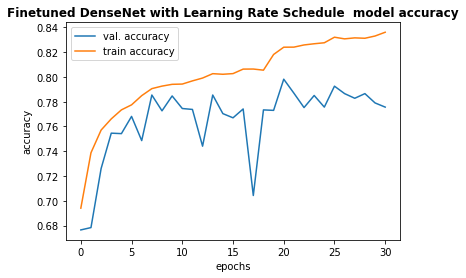

In [33]:
# densenet model accuracy plot
plt.plot(densenet_history_lite.history['val_acc'], label="val. accuracy")
plt.plot(densenet_history_lite.history['acc'],  label="train accuracy")
plt.title('Finetuned DenseNet with Learning Rate Schedule  model accuracy', fontweight='bold')
plt.ylabel('accuracy')
plt.xlabel('epochs')
plt.legend()
plt.savefig(base_path + 'Finetuned DenseNet with Learning Rate Schedule  model accuracy.jpg',bbox_inches='tight')
plt.show()

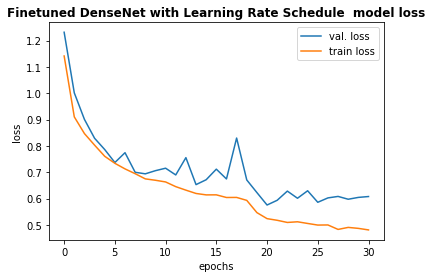

In [34]:
# densenet model accuracy plot
plt.plot(densenet_history_lite.history['val_loss'], label="val. loss")
plt.plot(densenet_history_lite.history['loss'],  label="train loss")
plt.title('Finetuned DenseNet with Learning Rate Schedule  model loss', fontweight='bold')
plt.ylabel('loss')
plt.xlabel('epochs')
plt.legend()
plt.savefig(base_path + 'Finetuned DenseNet with Learning Rate Schedule model loss.jpg',bbox_inches='tight')
plt.show()

In [35]:
# save history as dataframe
densenet_lite_finetuned_history_df = pd.DataFrame(densenet_history_lite.history)

# save training history
pickle.dump(densenet_history_lite.history, open( 'densenet_lite_finetuned_history' + '.pickle', "wb"))

In [36]:
# load densenet training data
densenet_lite_finetuned_history = open('densenet_lite_finetuned_history' + '.pickle', "rb")

In [37]:
# show densenet training history
densenet_lite_finetuned_history_df

,loss,acc,val_loss,val_acc,lr
0,1.141312,0.694106,1.231481,0.676548,0.00500
1,0.910139,0.738789,1.001287,0.678424,0.00500
2,0.846707,0.757100,0.900643,0.726079,0.00500
3,0.802783,0.766122,0.828895,0.754597,0.00500
4,0.760463,0.773382,0.786075,0.754221,0.00500
5,0.733838,0.777440,0.736763,0.768105,0.00500
6,0.712635,0.784860,0.774120,0.748593,0.00500
7,0.694389,0.790519,0.699746,0.785366,0.00500
8,0.674725,0.792548,0.693880,0.772608,0.00500
9,0.669450,0.793989,0.705875,0.784615,0.00500


**Model 4: InceptionResNet**

**InceptionResNet With Learning Rate Schedule**

In [37]:
# Fine Tuning Model InceptionResNet V2
from tensorflow.keras.applications import InceptionResNetV2
def create_frozen_inceptionres_model_lite():

    # import inception resnet v2 model
    inceptionres_model = InceptionResNetV2(include_top = False, weights = 'imagenet', input_tensor = Input(shape=(224, 224, 3)))
    # freeze base layer
    for layer in inceptionres_model.layers[:-3]:
      layer.trainable = False
    # check frozen layers
    for i, layer in enumerate(inceptionres_model.layers):
      print(i, layer.name, layer.trainable)
    
    # define inputs
    inputs = tf.keras.layers.Input(shape=(224, 224, 3))
    # do data augmentation on inputs
    x = img_augmentation(inputs)
    # call the base model on x
    x =  inceptionres_model(x)

    # Fine-tuning
      # Combos
    x = tf.keras.layers.GlobalAveragePooling2D()(x) #add global average pooling layer - color 
    x = Dense(64, kernel_initializer = 'he_normal', kernel_regularizer='l2')(x) #l2(1e-3) #activation = "relu",
    x = BatchNormalization()(x)
    x = Dropout(rate = 0.5)(x)
    x = ReLU()(x)
      # Combos
   # x = Dense(64, activation = "relu", kernel_initializer = 'he_normal', kernel_regularizer='l2')(x) #activation = "relu",
    #x = BatchNormalization()(x)
    #x = Dropout(rate = 0.5)(x)
    #x = ReLU()(x)

    # Output layer - output dimension=5 because we have 5 classes
    outputs = tf.keras.layers.Dense(5, activation = "softmax")(x)

    # Put the model together
    model = tf.keras.Model(inputs=inputs, outputs=outputs)

    # compile model with Adam, sparse_categorical_crossentropy loss, and accuracy metric
    model.compile(optimizer = Adam(lr=0.005), #learning_rate=expo_decay_lr_schedule
                  loss = "sparse_categorical_crossentropy",
                  metrics = ["acc"])
    
    return model


In [38]:
frozen_inceptionres_lite = create_frozen_inceptionres_model_lite() 
frozen_inceptionres_lite.summary() 

219062272/219055592 [==============================] - 1s 0us/step
0 input_3 False
1 conv2d False
2 batch_normalization_1 False
3 activation False
4 conv2d_1 False
5 batch_normalization_2 False
6 activation_1 False
7 conv2d_2 False
8 batch_normalization_3 False
9 activation_2 False
10 max_pooling2d False
11 conv2d_3 False
12 batch_normalization_4 False
13 activation_3 False
14 conv2d_4 False
15 batch_normalization_5 False
16 activation_4 False
17 max_pooling2d_1 False
18 conv2d_8 False
19 batch_normalization_9 False
20 activation_8 False
21 conv2d_6 False
22 conv2d_9 False
23 batch_normalization_7 False
24 batch_normalization_10 False
25 activation_6 False
26 activation_9 False
27 average_pooling2d False
28 conv2d_5 False
29 conv2d_7 False
30 conv2d_10 False
31 conv2d_11 False
32 batch_normalization_6 False
33 batch_normalization_8 False
34 batch_normalization_11 False
35 batch_normalization_12 False
36 activation_5 False
37 activation_7 False
38 activation_10 False
39 activation_11 Fa

In [39]:
# fit inceptionres model and track history - freeze all just GAP, reduce lr schedule 1, just lr = 0.1
inceptionres_lite_history_lite = frozen_inceptionres_lite.fit(
    train_dataset,
    epochs = EPOCHS,
    validation_data = valid_dataset,
    verbose = 1, 
    batch_size=128,
    callbacks=[early_stopping_callback, reduce_lr_callback, tensorboard_callback('inceptionres_lite_finetuned_history')] # reduce_lr_callback, 
)

Epoch 1/100
293/293 [==============================] - 93s 271ms/step - loss: 1.5076 - acc: 0.6304 - val_loss: 1.0743 - val_acc: 0.6679
Epoch 2/100
293/293 [==============================] - 76s 255ms/step - loss: 0.9826 - acc: 0.6908 - val_loss: 0.9194 - val_acc: 0.7099
Epoch 3/100
293/293 [==============================] - 76s 254ms/step - loss: 0.9402 - acc: 0.7149 - val_loss: 0.9812 - val_acc: 0.7092
Epoch 4/100
293/293 [==============================] - 76s 254ms/step - loss: 0.9112 - acc: 0.7159 - val_loss: 0.8956 - val_acc: 0.7148
Epoch 5/100
293/293 [==============================] - 76s 254ms/step - loss: 0.8940 - acc: 0.7245 - val_loss: 0.8793 - val_acc: 0.7250
Epoch 6/100
293/293 [==============================] - 76s 254ms/step - loss: 0.8870 - acc: 0.7300 - val_loss: 0.8791 - val_acc: 0.7253
Epoch 7/100
293/293 [==============================] - 76s 254ms/step - loss: 0.8872 - acc: 0.7352 - val_loss: 0.8765 - val_acc: 0.7238
Epoch 8/100
293/293 [===========================

In [40]:
# function to save the model just trained
def save_model(model):
  import os
  model_name = 'inceptionres_lite_finetuned_model.h5'
  save_dir = os.path.join(base_path, 'saved_models')
  
  # Save model and weights
  if not os.path.isdir(save_dir):
      os.makedirs(save_dir)
  model_path = os.path.join(save_dir, model_name)
  model.save(model_path)
  print('Saved trained model at %s ' % model_path)

In [41]:
# save the model
save_model(frozen_inceptionres_lite)

Saved trained model at /tmp/kaggle-data/saved_models/inceptionres_lite_finetuned_model.h5 


In [42]:
# load the model
from keras.models import load_model
frozen_inceptionres_lite = load_model('/tmp/kaggle-data/saved_models/inceptionres_lite_finetuned_model.h5')
'done !'

'done !'

In [43]:
frozen_inceptionres_lite.evaluate(valid_dataset, batch_size=BATCH, verbose=1, 
                               callbacks= [early_stopping_callback, reduce_lr_callback])

42/42 [==============================] - 15s 240ms/step - loss: 0.6441 - acc: 0.7685


[0.6440594792366028, 0.7684803009033203]

In [ ]:
# save tensorboard
!tensorboard dev upload \
--logdir logs \
--name "midterm_project_inceptionres_lite_finetuned" \
--description "Tensorboard of InceptionResV2 with Learning Rate Schedule model for Cassava Leaf Disease Classification"
--one_shot

**Link to TensorBoard for InceptionResNet with Learning Rate Schedule**
https://tensorboard.dev/experiment/ILb59joMQoiWAJwFZTG4ZQ/#scalars



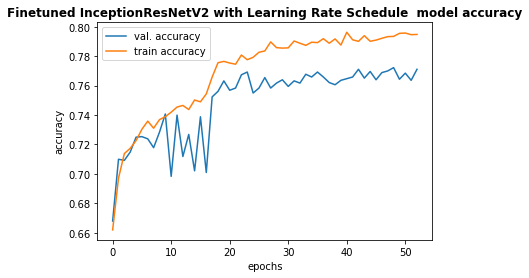

In [44]:
# InceptionResV2 model accuracy plot
plt.plot(inceptionres_lite_history_lite.history['val_acc'], label="val. accuracy")
plt.plot(inceptionres_lite_history_lite.history['acc'],  label="train accuracy")
plt.title('Finetuned InceptionResNetV2 with Learning Rate Schedule  model accuracy', fontweight='bold')
plt.ylabel('accuracy')
plt.xlabel('epochs')
plt.legend()
plt.savefig(base_path + 'Finetuned InceptionResNetV2 with Learning Rate Schedule model accuracy.jpg',bbox_inches='tight')
plt.show()

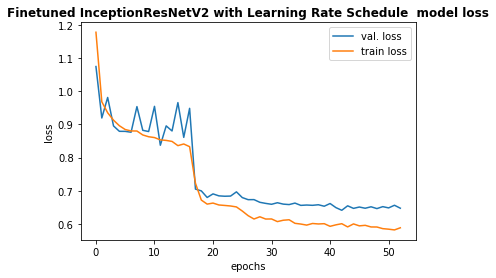

In [45]:
# InceptionResV2 model loss plot
plt.plot(inceptionres_lite_history_lite.history['val_loss'], label="val. loss")
plt.plot(inceptionres_lite_history_lite.history['loss'],  label="train loss")
plt.title('Finetuned InceptionResNetV2 with Learning Rate Schedule  model loss', fontweight='bold')
plt.ylabel('loss')
plt.xlabel('epochs')
plt.legend()
plt.savefig(base_path + 'Finetuned InceptionResNetV2 with Learning Rate Schedule model loss.jpg',bbox_inches='tight')
plt.show()

In [46]:
# save history as dataframe
inceptionres_lite_history_lite_df = pd.DataFrame(inceptionres_lite_history_lite.history)

# save training history
pickle.dump(inceptionres_lite_history_lite.history, open( 'inceptionres_lite_finetuned_history' + '.pickle', "wb"))

In [47]:
# load densenet training data
inceptionres_lite_finetuned_history = open('inceptionres_lite_finetuned_history' + '.pickle', "rb")

In [48]:
# show densenet training history
inceptionres_lite_history_lite_df

,loss,acc,val_loss,val_acc,lr
0,1.177582,0.661915,1.074300,0.667917,0.005000
1,0.968186,0.697096,0.919388,0.709944,0.005000
2,0.935119,0.713805,0.981219,0.709193,0.005000
3,0.912834,0.717382,0.895558,0.714822,0.005000
4,0.896097,0.722614,0.879276,0.724953,0.005000
5,0.884646,0.730354,0.879112,0.725328,0.005000
6,0.880398,0.735853,0.876534,0.723827,0.005000
7,0.880157,0.731048,0.953680,0.717824,0.005000
8,0.868304,0.736867,0.882295,0.728330,0.005000
9,0.862947,0.738896,0.878620,0.740713,0.005000
